In [1]:
import numpy as np
import torch 
import matplotlib.pyplot as plt 
import pickle 
from sklearn.manifold import TSNE

from common import *
from hydra import initialize, compose


In [2]:
%cd ..


/home/skshyn/crossdomain/ER-TRL


In [3]:
from launch_experiment import initialize as init_agent
import rlkit.torch.pytorch_util as ptu


Gym has been unmaintained since 2022 and does not support NumPy 2.0 amongst other critical functionality.
Please upgrade to Gymnasium, the maintained drop-in replacement of Gym, or contact the authors of your software and request that they upgrade.
See the migration guide at https://gymnasium.farama.org/introduction/migration_guide/ for additional information.
/home/skshyn/miniconda3/envs/omrl/lib/python3.12/site-packages/Cython/Distutils/old_build_ext.py:15: DeprecationWarning: dep_util is Deprecated. Use functions from setuptools instead.
  from distutils.dep_util import newer, newer_group
<frozen importlib._bootstrap>:530: DeprecationWarning: the load_module() method is deprecated and slated for removal in Python 3.12; use exec_module() instead


import module: half_cheetah_vel
import module: humanoid_dir
import module: ant_dir
import module: hopper_params
import module: ant_goal
import module: walker_params
import module: point_robot
import module: half_cheetah_dir
import module: wrappers


<frozen importlib._bootstrap>:488: DeprecationWarning: Type google.protobuf.pyext._message.ScalarMapContainer uses PyType_Spec with a metaclass that has custom tp_new. This is deprecated and will no longer be allowed in Python 3.14.
<frozen importlib._bootstrap>:488: DeprecationWarning: Type google.protobuf.pyext._message.MessageMapContainer uses PyType_Spec with a metaclass that has custom tp_new. This is deprecated and will no longer be allowed in Python 3.14.


In [8]:
def load_agent(env, algo='offlinepearl'):
    with initialize(version_base="1.3", config_path="../cfgs", ):
        cfg = compose('experiment', overrides=[f'+env={env}', f'+algo={algo}'])
    agent = init_agent(cfg)
    return agent, cfg


In [9]:
def get_actions_per_task(agent, train_tasks=None, eval_tasks=None, batch_size=1000):
    """
    Get actions from offline data for each task.
    
    Args:
        agent: The loaded agent
        train_tasks: List of train task indices to use (None means use all from agent.train_tasks)
        eval_tasks: List of eval task indices to use (None means use all from agent.eval_tasks)
        batch_size: Number of samples per task
    
    Returns:
        actions_list: List of action arrays, one per task
        task_indices: List of task indices
        task_labels: List of task labels (goal/mode info)
    """
    if train_tasks is None:
        train_tasks = agent.train_tasks
    if eval_tasks is None:
        eval_tasks = agent.eval_tasks
    
    all_indices = list(train_tasks) + list(eval_tasks)
    all_indices = np.array(all_indices)
    sorted_indices = np.argsort(all_indices)
    
    actions_list = []
    task_labels = []
    
    # Get actions from train tasks
    for idx in train_tasks:
        batch = agent.replay_buffer.random_batch(idx, batch_size=batch_size)
        actions = batch['actions']
        actions_list.append(actions)
        # Get task label
        agent.env.reset_task(idx)
        goal = np.round(agent.env._goal, 2)
        mode = agent.env.get_mode()
        task_labels.append(f'Train: {goal} ({mode})')
    
    # Get actions from eval tasks (moderate)
    for idx in eval_tasks:
        batch = agent.eval_buffer.random_batch(idx, batch_size=batch_size)
        actions = batch['actions']
        actions_list.append(actions)
        # Get task label
        agent.env.reset_task(idx)
        goal = np.round(agent.env._goal, 2)
        mode = agent.env.get_mode()
        task_labels.append(f'Moderate: {goal} ({mode})')
    
    # Sort by task indices
    actions_list = [actions_list[i] for i in sorted_indices]
    task_labels = [task_labels[i] for i in sorted_indices]
    all_indices = all_indices[sorted_indices]
    
    return actions_list, all_indices, task_labels


In [10]:
def apply_tsne_to_actions(actions_list, n_components=2, random_state=42):
    """
    Apply t-SNE to actions from all tasks.
    
    Args:
        actions_list: List of action arrays, one per task
        n_components: Number of t-SNE components (default: 2)
        random_state: Random state for reproducibility
    
    Returns:
        tsne_results: List of t-SNE embeddings, one per task
    """
    # Concatenate all actions
    all_actions = np.concatenate(actions_list, axis=0)
    
    # Apply t-SNE
    tsne = TSNE(n_components=n_components, random_state=random_state, perplexity=30)
    tsne_embedding = tsne.fit_transform(all_actions)
    
    # Split back by task
    tsne_results = []
    start_idx = 0
    for actions in actions_list:
        end_idx = start_idx + len(actions)
        tsne_results.append(tsne_embedding[start_idx:end_idx])
        start_idx = end_idx
    
    return tsne_results


In [ ]:
# Load agent for halfcheetah-custom-vel
# env_name = 'cheetah-vel-custom'
env_name = 'cheetah-vel'
env_name1 = 'cheetah-vel-custom'
agent, cfg = load_agent(env=env_name)


In [16]:
# Get actions for all tasks from config
# Use train_tasks and eval_tasks directly from agent (which comes from config)
actions_list, task_indices, task_labels = get_actions_per_task(
    agent, 
    train_tasks=agent.train_tasks,  # Use all train tasks from config
    eval_tasks=agent.eval_tasks,    # Use all eval tasks (moderate) from config
    batch_size=1000
)


In [17]:
print(f"Number of tasks: {len(actions_list)}")
print(f"Action dimension: {actions_list[0].shape[1]}")
print(f"Number of samples per task: {[len(actions) for actions in actions_list]}")


Number of tasks: 30
Action dimension: 6
Number of samples per task: [1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000, 1000]


In [18]:
# Apply t-SNE to actions
tsne_results = apply_tsne_to_actions(actions_list, n_components=2, random_state=42)


In [26]:
len(tsne_results)

30

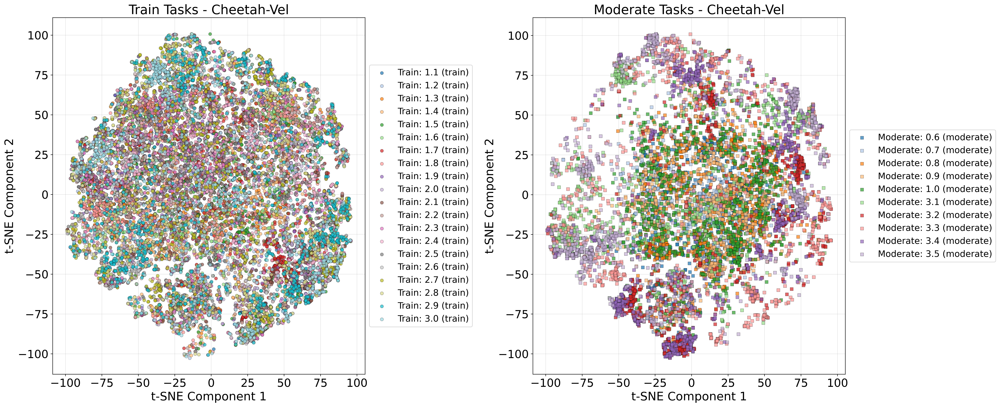

In [33]:
# Set up plotting parameters
plt.rcParams["figure.dpi"] = 400
plt.rcParams["font.size"] = 19
plt.rcParams["legend.fontsize"] = 15
plt.rcParams["text.usetex"] = False  # LaTeX가 설치되어 있지 않으면 False로 설정
plt.rcParams["figure.autolayout"] = True

# Separate train and moderate tasks
# Moderate tasks are the first 5 and last 5 tasks (after sorting by task indices)
# Train tasks are in the middle
moderate_indices_mask = [label.startswith('Moderate:') for label in task_labels]
train_indices_mask = [label.startswith('Train:') for label in task_labels]

# Get moderate tasks (first 5 and last 5)
moderate_tsne = [tsne_results[i] for i in range(len(tsne_results)) if moderate_indices_mask[i]]
moderate_labels_plot = [task_labels[i] for i in range(len(task_labels)) if moderate_indices_mask[i]]
moderate_indices_list = [task_indices[i] for i in range(len(task_indices)) if moderate_indices_mask[i]]

# Get train tasks (middle tasks)
train_tsne = [tsne_results[i] for i in range(len(tsne_results)) if train_indices_mask[i]]
train_labels_plot = [task_labels[i] for i in range(len(task_labels)) if train_indices_mask[i]]
train_indices_list = [task_indices[i] for i in range(len(task_indices)) if train_indices_mask[i]]

# Create distinct color maps for train and moderate tasks
# Use tab20 for more distinct colors (20 different colors)
cm_train = plt.get_cmap('tab20')
cm_moderate = plt.get_cmap('tab20')

# Get distinct colors for each task
train_colors = [cm_train(i % 20) for i in range(len(train_tsne))]
moderate_colors = [cm_moderate(i % 20) for i in range(len(moderate_tsne))]

# Create two separate subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 10))

# Plot train tasks on the left subplot
train_lines = []
for i, (tsne_emb, label) in enumerate(zip(train_tsne, train_labels_plot)):
    l = ax1.scatter(tsne_emb[:, 0], tsne_emb[:, 1], s=30, label=label, alpha=0.7, 
                   color=train_colors[i], marker='o', edgecolors='black', linewidths=0.3)
    train_lines.append(l)

ax1.set_xlabel('t-SNE Component 1', fontsize=20)
ax1.set_ylabel('t-SNE Component 2', fontsize=20)
ax1.set_title(f'Train Tasks - {env_names[env_name1]}', fontsize=22)
ax1.legend(train_lines, train_labels_plot, loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
ax1.grid(True, alpha=0.3)

# Plot moderate tasks on the right subplot
moderate_lines = []
for i, (tsne_emb, label) in enumerate(zip(moderate_tsne, moderate_labels_plot)):
    l = ax2.scatter(tsne_emb[:, 0], tsne_emb[:, 1], s=30, label=label, alpha=0.7, 
                   color=moderate_colors[i], marker='s', edgecolors='black', linewidths=0.3)
    moderate_lines.append(l)

ax2.set_xlabel('t-SNE Component 1', fontsize=20)
ax2.set_ylabel('t-SNE Component 2', fontsize=20)
ax2.set_title(f'Moderate Tasks - {env_names[env_name1]}', fontsize=22)
ax2.legend(moderate_lines, moderate_labels_plot, loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()


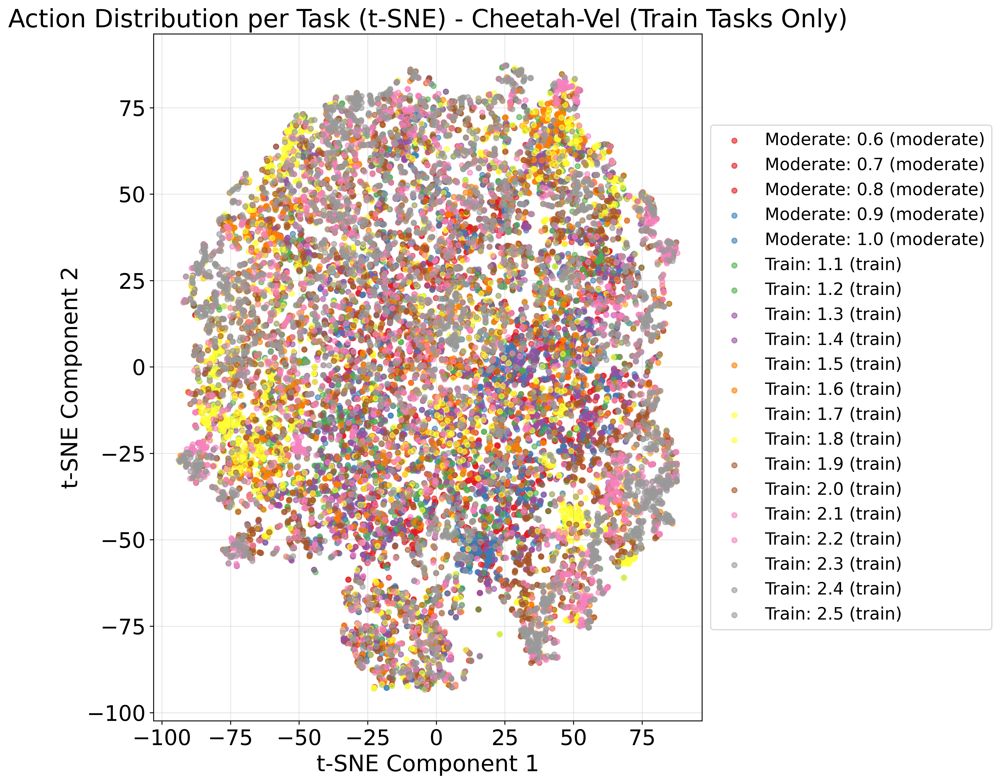

In [36]:
# Optional: Plot only train tasks
n_train = len(agent.train_tasks)
train_actions = actions_list[:n_train]
train_labels = task_labels[:n_train]
train_indices = task_indices[:n_train]

tsne_train = apply_tsne_to_actions(train_actions, n_components=2, random_state=42)

fig, ax = plt.subplots(1, 1, figsize=(12, 10))
cm = plt.get_cmap('Set1')
colors = cm(np.linspace(0, 1, len(tsne_train)))

lines = []
labels = []

for i, (tsne_emb, label) in enumerate(zip(tsne_train, train_labels)):
    l = ax.scatter(tsne_emb[:, 0], tsne_emb[:, 1], s=20, label=label, alpha=0.6, color=colors[i])
    lines.append(l)
    labels.append(label)

ax.set_xlabel('t-SNE Component 1', fontsize=20)
ax.set_ylabel('t-SNE Component 2', fontsize=20)
ax.set_title(f'Action Distribution per Task (t-SNE) - {env_names[env_name1]} (Train Tasks Only)', fontsize=22)
ax.legend(lines, labels, loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()


Number of tasks: 30
Initial state dimension: 20
Number of samples per task: 10

=== Checking if initial states are deterministic ===
Task 5 (Goal: 0.6, Mode: moderate): Max std=0.135345, Mean std=0.072096
  -> Initial state is STOCHASTIC (varies across resets)
Task 6 (Goal: 0.7, Mode: moderate): Max std=0.123995, Mean std=0.067201
  -> Initial state is STOCHASTIC (varies across resets)
Task 7 (Goal: 0.8, Mode: moderate): Max std=0.134702, Mean std=0.069622
  -> Initial state is STOCHASTIC (varies across resets)
Task 8 (Goal: 0.9, Mode: moderate): Max std=0.118828, Mean std=0.067887
  -> Initial state is STOCHASTIC (varies across resets)
Task 9 (Goal: 1.0, Mode: moderate): Max std=0.161484, Mean std=0.071779
  -> Initial state is STOCHASTIC (varies across resets)

=== Checking if initial states differ between tasks ===
Task 6 vs Task 5: Max diff=0.076932, Mean diff=0.025021 (Goal: 0.7, Mode: moderate)
Task 7 vs Task 5: Max diff=0.128530, Mean diff=0.029448 (Goal: 0.8, Mode: moderate)
Ta

In [ ]:
# Optional: Plot only moderate tasks
n_train = len(agent.train_tasks)
moderate_actions = actions_list[n_train:]
moderate_labels = task_labels[n_train:]
moderate_indices = task_indices[n_train:]

tsne_moderate = apply_tsne_to_actions(moderate_actions, n_components=2, random_state=42)

fig, ax = plt.subplots(1, 1, figsize=(12, 10))
cm = plt.get_cmap('Set1')
colors = cm(np.linspace(0, 1, len(tsne_moderate)))

lines = []
labels = []

for i, (tsne_emb, label) in enumerate(zip(tsne_moderate, moderate_labels)):
    l = ax.scatter(tsne_emb[:, 0], tsne_emb[:, 1], s=20, label=label, alpha=0.6, color=colors[i])
    lines.append(l)
    labels.append(label)

ax.set_xlabel('t-SNE Component 1', fontsize=20)
ax.set_ylabel('t-SNE Component 2', fontsize=20)
ax.set_title(f'Action Distribution per Task (t-SNE) - {env_names[env_name1]} (Moderate Tasks Only)', fontsize=22)
ax.legend(lines, labels, loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()


In [43]:
def get_context(agent, env_name, train_idx=(0, 4, 9, 15, 18), moderate_idx=(0,5,9), batch_size=256):
    indices = [task_id_conv[env_name]['train'][idx] for idx in train_idx]
    moderate_indices = [task_id_conv[env_name]['moderate'][idx] for idx in moderate_idx]
    
    batches = [ptu.np_to_pytorch_batch(agent.replay_buffer.random_batch(idx, batch_size=batch_size)) for idx in indices]
    moderate_batches = [ptu.np_to_pytorch_batch(agent.eval_buffer.random_batch(idx, batch_size=batch_size)) for idx in moderate_indices]
    indices.extend(moderate_indices)
    batches.extend(moderate_batches)
    indices=np.array(indices)
    sorted_indices = np.argsort(indices)

    context = [agent.unpack_batch(batch, sparse_reward=False) for batch in batches]
    # group like elements together
    context = [[x[i] for x in context] for i in range(len(context[0]))]
    context = [torch.cat(x, dim=0) for x in context] # 5 * self.meta_batch * self.embedding_batch_size * dim(o, a, r, no, t)
    # full context consists of [obs, act, rewards, next_obs, terms]
    # if dynamics don't change across tasks, don't include next_obs
    # don't include terminals in context
    if agent.use_next_obs_in_context:
        context = torch.cat(context[:-1], dim=2)
    else:
        context = torch.cat(context[:-2], dim=2)
        
    indices = indices[sorted_indices]
    context = context[sorted_indices]
    tasks = []
    return context, indices 

def load_encoder(agent, env_name, algo, seed=0):
    encoder = agent.agent.context_encoder 
    path = f'/ext/skshyn/output/{env_name}/{algo}/seed{seed}/agent.pth'
    checkpoint = torch.load(path)
    encoder.load_state_dict(checkpoint['context_encoder'])    
    return encoder

In [38]:
def embed(context, encoder):
    z = encoder(context)
    task, batch, _ = z.shape 
    z = z.reshape(task*batch, -1).detach().cpu().numpy()
    embed = TSNE(n_components=2, ).fit_transform(z)
    return embed.reshape(task, batch, -1)


In [51]:
agent, cfg = load_agent(env='cheetah-vel')
context, indices = get_context(agent, cfg.env_name, train_idx = agent.train_tasks, moderate_idx=agent.eval_tasks, batch_size=256)
total_x = []
encoder = load_encoder(agent, cfg.env_name, 'OfflinePearl',)
x = embed(context, encoder)

/home/skshyn/miniconda3/envs/omrl/lib/python3.12/site-packages/gym/spaces/box.py:84: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(f"Box bound precision lowered by casting to {self.dtype}")
/home/skshyn/miniconda3/envs/omrl/lib/python3.12/site-packages/gym/core.py:172: DeprecationWarning: WARN: Function `env.seed(seed)` is marked as deprecated and will be removed in the future. Please use `env.reset(seed=seed) instead.
  deprecation(


---------- Networks initialized -------------
[Network] Total number of parameters : 0.235 M
-----------------------------------------------
---------- Networks initialized -------------
[Network] Total number of parameters : 0.144 M
-----------------------------------------------
---------- Networks initialized -------------
[Network] Total number of parameters : 0.144 M
-----------------------------------------------
---------- Networks initialized -------------
[Network] Total number of parameters : 0.142 M
-----------------------------------------------
---------- Networks initialized -------------
[Network] Total number of parameters : 0.144 M
-----------------------------------------------
---------- Networks initialized -------------
[Network] Total number of parameters : 0.094 M
-----------------------------------------------


IndexError: list index out of range

In [49]:
agent.train_tasks

[10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29]

In [47]:
x.shape

(8, 256, 2)